## Starter Code

In [195]:
import gc
import pickle
from tqdm import tqdm
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from matplotlib.backends.backend_pdf import PdfPages


from boltzmann_machine import BoltzmannMachine

from utils import (plot_sigmoid,
                   get_encprob_env_states, 
                   get_encprob_weight_mask, 
                   gen_free_state_dist_pdf, 
                   gen_clamped_state_dist_pdf, 
                   gen_learning_plots_pdf,
                   get_boltzmann_distribution,
                   get_probs_from_counts,
                   plot_series,
                   generate_binary_vectors)

In [196]:
grp_size = 4
num_hnodes = 2
env_states = get_encprob_env_states(grp_size)
weight_mask = get_encprob_weight_mask(grp_size, num_hnodes) # two vis grps should not interact with each other and hidden units should not interact with each other

In [197]:
base_dir = './saved_run/nc_signed_fixedFreeRun_noiseMultiple10_1/'

with open(f'{base_dir}/bm_object_free_run_debug.pkl', 'rb') as inp:
    free_run_debug = pickle.load(inp)

with open(f'{base_dir}/bm_object_clamped_run_debug.pkl', 'rb') as inp:
    clamped_run_debug = pickle.load(inp)

with open(f'{base_dir}/bm_object_learning_debug.pkl', 'rb') as inp:
    learning_debug = pickle.load(inp)


#######################################
for i in range(0):##################################################
    with open(f'{base_dir}/bm_object_free_run_debug_{i+1}.pkl', 'rb') as inp:
        free_run_debug.extend(pickle.load(inp)) 

    with open(f'{base_dir}/bm_object_clamped_run_debug_{i+1}.pkl', 'rb') as inp:
        clamped_run_debug.extend(pickle.load(inp))

    with open(f'{base_dir}/bm_object_learning_debug_{i+1}.pkl', 'rb') as inp:
        learning_debug.extend(pickle.load(inp))



bm = BoltzmannMachine(env_states, num_hnodes, weight_mask)
bm.free_run_debug = free_run_debug
bm.clamped_run_debug = clamped_run_debug
bm.learning_debug = learning_debug
print('Number of cycles: ', len(bm.learning_debug))


#--------------------------------------------------
p_matrix_series = []
p_prime_matrix_series = []
dir_matrix_series = []
W_matrix_series = []

for i in range(len(bm.learning_debug)):
    p_matrix_series.append(bm.learning_debug[i]['p'])
    p_prime_matrix_series.append(bm.learning_debug[i]['p_prime'])
    dir_matrix_series.append(bm.learning_debug[i]['direction'])
    W_matrix_series.append(bm.learning_debug[i]['W'])

p_matrix_series = np.stack(p_matrix_series, axis=0)
p_prime_matrix_series = np.stack(p_prime_matrix_series, axis=0)


# dir_matrix_series = np.stack(dir_matrix_series, axis=0)
dir_matrix_series = p_matrix_series-p_prime_matrix_series
# dir_matrix_series = dir_matrix_series.reshape((200, 2, 11, 11)).mean(axis=1) #***********************


W_matrix_series = np.stack(W_matrix_series, axis=0)
#--------------------------------------------------

Number of cycles:  1500


In [198]:
i = -1
p = bm.learning_debug[i]['p']
p_prime = bm.learning_debug[i]['p_prime']
direction = bm.learning_debug[i]['direction']
W = bm.learning_debug[i]['W']

print(W.max(), W.min())
W

44.0 -48.0


array([[  0., -16., -28.,  22.,   0.,   0.,   0.,   0.,  44., -32., -20.],
       [-16.,   0.,   8., -22.,   0.,   0.,   0.,   0., -46., -38.,  28.],
       [-28.,   8.,   0.,  -8.,   0.,   0.,   0.,   0.,  40.,  28., -46.],
       [ 22., -22.,  -8.,   0.,   0.,   0.,   0.,   0., -42.,  36., -14.],
       [  0.,   0.,   0.,   0.,   0., -20., -18.,  10.,  42., -26., -18.],
       [  0.,   0.,   0.,   0., -20.,   0.,  10., -14., -36., -46.,  22.],
       [  0.,   0.,   0.,   0., -18.,  10.,   0., -20.,  34.,  34., -48.],
       [  0.,   0.,   0.,   0.,  10., -14., -20.,   0., -30.,  40., -16.],
       [ 44., -46.,  40., -42.,  42., -36.,  34., -30.,   0.,   0.,  -2.],
       [-32., -38.,  28.,  36., -26., -46.,  34.,  40.,   0.,   0.,  -2.],
       [-20.,  28., -46., -14., -18.,  22., -48., -16.,  -2.,  -2.,   0.]])

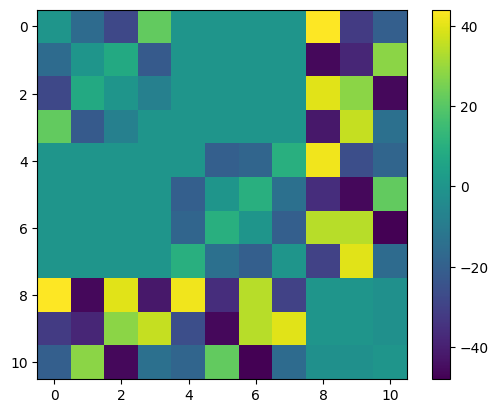

In [199]:
plt.imshow(bm.learning_debug[-1]['W'])
plt.colorbar()

In [200]:
for i, clamped_debug_list in enumerate(bm.clamped_run_debug):
    for clamped_dist in clamped_debug_list:
      #  print(clamped_dist['states'][clamped_dist['state_counts'].argmax()][-3:-1], end=', ')
      bm.clamped_run_eval(clamped_dist)

    free_run_dist = bm.free_run_debug[i]
    bm.free_run_eval(free_run_dist)

[0. 0.], [1. 0.], [1. 0.], [0. 0.], [68, 69, 70, 71, 132, 133, 134, 135, 261, 262, 263, 264, 527, 528, 529, 530]
[1. 1.], [0. 0.], [0. 0.], [0. 0.], [20, 25, 30, 35, 52, 59, 67, 76, 140, 145, 150, 155, 166, 176, 199, 235]
[0. 0.], [1. 0.], [0. 0.], [0. 0.], [20, 27, 28, 38, 39, 46, 63, 79, 144, 150, 151, 171, 172, 188, 207, 246]
[0. 0.], [0. 0.], [1. 0.], [0. 0.], [25, 30, 35, 40, 47, 67, 78, 79, 84, 85, 91, 102, 155, 165, 176, 247]
[0. 0.], [0. 0.], [0. 0.], [0. 0.], [18, 23, 31, 42, 49, 60, 69, 85, 90, 103, 113, 123, 154, 176, 204, 239]
[0. 0.], [0. 0.], [0. 0.], [0. 0.], [6, 24, 26, 33, 40, 58, 62, 92, 93, 130, 134, 139, 168, 188, 197, 289]
[1. 0.], [0. 0.], [0. 0.], [0. 0.], [14, 25, 36, 41, 46, 51, 59, 89, 97, 103, 117, 125, 137, 150, 157, 197]
[0. 0.], [0. 0.], [0. 0.], [0. 0.], [17, 21, 24, 30, 36, 48, 51, 75, 80, 114, 126, 144, 146, 150, 161, 245]
[0. 0.], [0. 0.], [1. 0.], [0. 1.], [12, 13, 18, 25, 46, 52, 54, 55, 56, 120, 131, 132, 164, 180, 239]
[0. 0.], [0. 0.], [1. 0.], [0

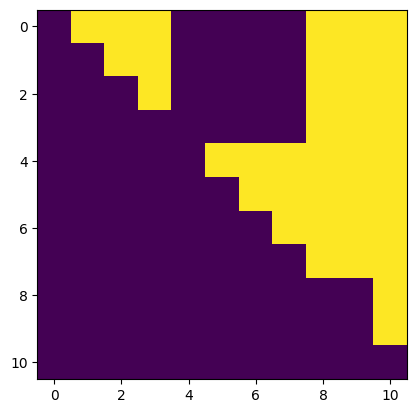

In [201]:
connections = np.zeros((bm.num_nodes, bm.num_nodes), dtype=bool)
plt.imshow(connections)

first_grp_connections = connections.copy()
first_grp_connections[:grp_size, :grp_size] = True
np.fill_diagonal(first_grp_connections, 0)
first_grp_connections = np.triu(first_grp_connections)
first_grp_concts_idxs = np.nonzero(first_grp_connections)
# plt.imshow(first_grp_connections)
# plt.show()

sec_grp_connections = connections.copy()
sec_grp_connections[grp_size:2*grp_size, grp_size:2*grp_size] = True
np.fill_diagonal(sec_grp_connections, 0)
sec_grp_connections = np.triu(sec_grp_connections)
sec_grp_concts_idxs = np.nonzero(sec_grp_connections)
# plt.imshow(sec_grp_connections)
# plt.show()

first_to_hidd_connections = connections.copy()
first_to_hidd_connections[:grp_size, -num_hnodes-1:-1] = True
first_to_hidd_concts_idxs = np.nonzero(first_to_hidd_connections)
# plt.imshow(first_to_hidd_connections)
# plt.show()


sec_to_hidd_connections = connections.copy()
sec_to_hidd_connections[grp_size:2*grp_size, -num_hnodes-1:-1] = True
sec_to_hidd_concts_idxs = np.nonzero(sec_to_hidd_connections)
# plt.imshow(sec_to_hidd_connections)
# plt.show()

all_to_bias_connections = connections.copy()
all_to_bias_connections[:-1, -1] = True
all_to_bias_concts_idxs = np.nonzero(all_to_bias_connections)
# plt.imshow(all_to_bias_connections)
# plt.show()


plt.imshow(first_grp_connections+sec_grp_connections + first_to_hidd_connections + sec_to_hidd_connections + all_to_bias_connections)
plt.show()

In [202]:
def get_series_data(idxs_arr):
    series_data1 = p_matrix_series[:, idxs_arr[0], idxs_arr[1]] 
    series_data2 = p_prime_matrix_series[:, idxs_arr[0], idxs_arr[1]] 
    series_data12 = dir_matrix_series[:, idxs_arr[0], idxs_arr[1]]
    series_data3 = W_matrix_series[:, idxs_arr[0], idxs_arr[1]]
    return series_data1, series_data2, series_data12, series_data3

def plot_series_data(idxs_arr, plot_p_p_prime=True, plot_dir=True, plot_W=True):
    series_data1, series_data2, series_data12, series_data3 = get_series_data(idxs_arr)
    for i in range(series_data1.shape[1]):
        if plot_p_p_prime:
            fig = go.Figure()
            fig.add_trace(go.Scatter(y=series_data1[:, i],
                                    mode='lines', 
                                    marker_color = 'green',
                                    name = f'p_{i+1}'))
            fig.add_trace(go.Scatter(y=series_data2[:, i],
                                mode='lines',
                                marker_color = 'red',
                                name = f'p_prime_{i+1}'))
            fig.add_hline(y=0)

            fig.show()

        if plot_dir:
            fig = go.Figure()
            fig.add_trace(go.Scatter(y=series_data12[:, i],
                                    mode='lines', 
                                    marker_color = 'blue'))
            fig.update_layout(
                title=dict(
                    text= f'dir_{i+1}'
                ))
            fig.add_hline(y=0)
            
            fig.show()

        if plot_W:
            fig = go.Figure()
            fig.add_trace(go.Scatter(y=series_data3[:, i],
                                    mode='lines', 
                                    marker_color = 'orange'))
            fig.update_layout(
                title=dict(
                    text= f'W_{i+1}'
                ))
            fig.add_hline(y=0)
            fig.show()

In [203]:
# bm = BoltzmannMachine(env_states, num_hnodes, weight_mask=weight_mask, noisy_clamping=True)
# a = bm.get_noisy_clamping_helper_data()

# arr = []
# arr.append((a[:250]==env_states[0]).sum(axis=0)/250)
# arr.append((a[250:500]==env_states[1]).sum(axis=0)/250)
# arr.append((a[500:750]==env_states[2]).sum(axis=0)/250)
# arr.append((a[750:1000]==env_states[3]).sum(axis=0)/250)

# arr = np.array(arr)
# plt.imshow(arr)
# plt.colorbar()

## Check Stability

### FIRST GROUP plot

In [204]:
plot_series_data(first_grp_concts_idxs, plot_dir=True, plot_p_p_prime=False, plot_W=False)

### SECOND GROUP plot

In [205]:
plot_series_data(sec_grp_concts_idxs, plot_dir=True, plot_p_p_prime=False, plot_W=False)

### FIRST TO HIDDEN plot

In [206]:
plot_series_data(first_to_hidd_concts_idxs, plot_dir=True, plot_p_p_prime=False, plot_W=False)

### SECOND TO HIDDEN plot

In [207]:
plot_series_data(sec_to_hidd_concts_idxs, plot_dir=True, plot_p_p_prime=False, plot_W=False)

### ALL TO BIAS plot

In [208]:
plot_series_data(all_to_bias_concts_idxs, plot_dir=True, plot_p_p_prime=False, plot_W=False)

## WEIGHTS Plots

### FIRST GROUP plot

In [209]:
plot_series_data(first_grp_concts_idxs, plot_dir=False, plot_p_p_prime=False, plot_W=True)

### SECOND GROUP plot

In [210]:
plot_series_data(sec_grp_concts_idxs, plot_dir=False, plot_p_p_prime=False, plot_W=True)

### FIRST TO HIDDEN plot

In [211]:
plot_series_data(first_to_hidd_concts_idxs, plot_dir=False, plot_p_p_prime=False, plot_W=True)

### SECOND TO HIDDEN plot

In [212]:
plot_series_data(sec_to_hidd_concts_idxs, plot_dir=False, plot_p_p_prime=False, plot_W=True)

### ALL TO BIAS plot

In [213]:
plot_series_data(all_to_bias_concts_idxs, plot_dir=False, plot_p_p_prime=False, plot_W=True)

## DIRECTION Plots

### FIRST GROUP plot

In [184]:
plot_series_data(first_grp_concts_idxs, plot_dir=False, plot_p_p_prime=True, plot_W=False)

### SECOND GROUP plot

In [185]:
plot_series_data(sec_grp_concts_idxs, plot_dir=False, plot_p_p_prime=True, plot_W=False)

### FIRST TO HIDDEN plot

In [186]:
plot_series_data(first_to_hidd_concts_idxs, plot_dir=False, plot_p_p_prime=True, plot_W=False)

### SECOND TO HIDDEN plot

In [187]:
plot_series_data(sec_to_hidd_concts_idxs, plot_dir=False, plot_p_p_prime=True, plot_W=False)

### ALL TO BIAS plot

In [188]:
plot_series_data(all_to_bias_concts_idxs, plot_dir=False, plot_p_p_prime=True, plot_W=False)

## GT plots

In [ ]:
# Example usage
length = 10
all_bin_vectors = generate_binary_vectors(length)
all_bin_num = all_bin_vectors.shape[0]
ones_col = np.ones((all_bin_num, 1), dtype=int)
all_bin_vectors = np.append(all_bin_vectors, ones_col, axis=1)
all_bin_vectors

array([[0, 0, 0, ..., 0, 0, 1],
       [0, 0, 0, ..., 0, 1, 1],
       [0, 0, 0, ..., 1, 0, 1],
       ...,
       [1, 1, 1, ..., 0, 1, 1],
       [1, 1, 1, ..., 1, 0, 1],
       [1, 1, 1, ..., 1, 1, 1]])

In [ ]:
gt_dists = []
learn_dists = []
sorted_free_run_states = []
gt_state_energy_progression = []
num_topMatches_list = []


for i, learn_debug_dict in enumerate(bm.learning_debug):
    bm_ = BoltzmannMachine(env_states, num_hnodes, init_W=learn_debug_dict['W'])
    all_bin_energies = [bm_.calc_energy(vec) for vec in all_bin_vectors]
    gt_state_energy_progression.append(all_bin_energies)

    gt_dist = np.array(sorted(zip(all_bin_energies, np.arange(all_bin_num)),
                     key=lambda x: x[0]))
    
    gt_dists.append(gt_dist)

    free_debug_dict = bm.free_run_debug[i]
    dist = np.array(sorted(zip(free_debug_dict['state_energies'], 
                               np.arange(len(free_debug_dict['state_energies'])),
                               free_debug_dict['state_counts']),
                     key=lambda x: x[0]))
    

    sorted_free_run_states.append(free_debug_dict['states'][dist[:, 1].astype(int)])
    learn_dists.append(dist)
    
    
    # returns the number of top matches, only "top" matches.
    non_matches = gt_dist[:dist.shape[0], 0] != dist[:, 0]
    
    if non_matches.any():
        num_top_matches = np.nonzero(non_matches)[0][0]
        num_topMatches_list.append(num_top_matches)
        print(num_top_matches, dist.shape[0], num_top_matches/dist.shape[0])
    else:
        print(dist.shape[0], dist.shape[0])

gt_state_energy_progression = np.array(gt_state_energy_progression)
gt_dists_arr = np.stack(gt_dists, axis=0)
print('\n minimum no. of top matches: ', min(num_topMatches_list))

# with PdfPages(f'{base_dir}/gt_dist.pdf') as pdf:
#     for i, gt_dist in enumerate(gt_dists[:]):
        
#         plt.plot(np.arange(all_bin_num)[:100], gt_dist[:100, 0])
        
#         learn_dist = learn_dists[i]
#         plt.plot(np.arange(learn_dist.shape[0])[:100], learn_dist[:100, 0], linestyle='dashed') # plot energies
#         # plt.plot(np.arange(learn_dist.shape[0]), learn_dist[:, 2], linestyle='dashed') # plot counts
        
#         pdf.savefig()  # Save the current figure into the PDF
#         plt.close()


with PdfPages(f'{base_dir}/compare_prob_dist.pdf') as pdf:
    for i, gt_dist in enumerate(gt_dists[:]):
        plt.figure(figsize=(20, 5))

        x = np.arange(all_bin_num)[:100]
        bm_probs = get_boltzmann_distribution(gt_dist[:, 0], bm.equil_time_temp[1])

        plt.plot(x, bm_probs[:100])
        
        learn_dist = learn_dists[i]
        learn_probs = get_probs_from_counts(learn_dist[:, 2])
        learn_probs = np.append(learn_probs, np.zeros(all_bin_num-learn_probs.shape[0]))
        plt.plot(x, learn_probs[:100], linestyle='dashed', linewidth=1)  
        
        pdf.savefig()  # Save the current figure into the PDF
        plt.close()

990 990
332 830 0.4
207 597 0.34673366834170855
258 538 0.4795539033457249
210 476 0.4411764705882353
279 491 0.5682281059063137
178 453 0.39293598233995586
190 432 0.4398148148148148
203 421 0.4821852731591449
241 439 0.5489749430523918
217 437 0.4965675057208238
168 425 0.3952941176470588
214 390 0.5487179487179488
171 388 0.44072164948453607
183 371 0.49326145552560646
185 430 0.43023255813953487
207 378 0.5476190476190477
173 364 0.47527472527472525
199 362 0.5497237569060773
176 290 0.6068965517241379
169 302 0.5596026490066225
147 266 0.5526315789473685
153 288 0.53125
87 271 0.3210332103321033
135 264 0.5113636363636364
149 257 0.5797665369649806
139 241 0.5767634854771784
138 255 0.5411764705882353
122 227 0.5374449339207048
91 216 0.4212962962962963
113 213 0.5305164319248826
107 228 0.4692982456140351
87 226 0.38495575221238937
108 245 0.44081632653061226
96 251 0.38247011952191234
116 251 0.46215139442231074
104 208 0.5
112 215 0.5209302325581395
118 248 0.47580645161290325


(array([2.860e+02, 1.063e+03, 1.160e+02, 1.100e+01, 6.000e+00, 8.000e+00,
        5.000e+00, 2.000e+00, 1.000e+00, 1.000e+00]),
 array([ 12.,  44.,  76., 108., 140., 172., 204., 236., 268., 300., 332.]),
 <BarContainer object of 10 artists>)

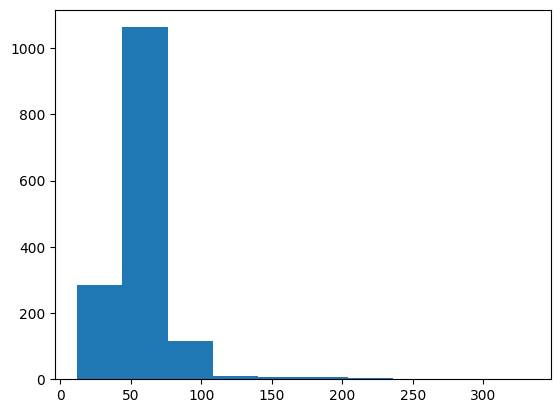

In [191]:
plt.hist(num_topMatches_list)

In [192]:
for gt_dist in gt_dists:
    top_four = all_bin_vectors[gt_dist[:4, 1].astype(int)]

    res_list = []
    for env_state in env_states:
        res = (top_four[:, :-3] == env_state).all(axis=1).any()
        res_list.append(res)
    
    print(gt_dist[:4, 0], sum(res_list))

[-0. -0. -0. -0.] 0
[-4. -2. -2. -0.] 0
[-8. -4. -4. -4.] 0
[-12.  -6.  -6.  -6.] 0
[-12.  -8.  -4.  -4.] 0
[-12.  -6.  -6.  -6.] 0
[-12.  -8.  -8.  -8.] 0
[-12. -10. -10.  -8.] 0
[-8. -8. -4. -4.] 0
[-18. -16. -16. -12.] 1
[-8. -8. -8. -8.] 0
[-10.  -6.  -6.  -6.] 0
[-0. -0. -0. -0.] 0
[-6. -2. -2. -2.] 0
[-4. -4. -0. -0.] 0
[-10. -10.  -6.  -6.] 1
[-12.  -8.  -8.  -4.] 1
[-10. -10.  -6.  -6.] 2
[-12.  -8.  -8.  -8.] 2
[-14.  -6.  -6.  -6.] 2
[-12.  -8.  -8.  -4.] 2
[-14. -10. -10.  -6.] 2
[-20. -20. -16. -12.] 2
[-22. -14. -14. -12.] 2
[-24. -16. -16. -14.] 2
[-22. -18. -12. -10.] 2
[-28. -20. -16. -16.] 1
[-22. -18. -16. -14.] 3
[-24. -16. -16. -16.] 2
[-22. -16. -14. -14.] 3
[-24. -22. -20. -16.] 3
[-26. -22. -20. -18.] 3
[-28. -28. -22. -20.] 4
[-34. -24. -22. -18.] 4
[-32. -24. -24. -22.] 4
[-34. -30. -28. -22.] 4
[-40. -24. -24. -22.] 3
[-30. -28. -26. -22.] 4
[-32. -28. -26. -26.] 3
[-38. -28. -26. -26.] 3
[-38. -36. -24. -24.] 3
[-30. -28. -26. -22.] 4
[-36. -30. -28. -20.] 3


In [129]:
with PdfPages(f'{base_dir}/gt_energy_bar_graph.pdf') as pdf:
    for gt_dist in tqdm(gt_dists):
        plt.figure(figsize=(20, 5))  

        edgecolors = np.array(['black']*100)
        edgecolors[[3, 4]] = 'g' # to highlight the difference between energies of env state and other states.
        
        linewidths = np.ones(100)
        linewidths[[3, 4]] = 3

        x = np.arange(all_bin_num)[:100]
        plt.bar(x, gt_dist[:100, 0], 
                edgecolor = edgecolors,
                linewidth = linewidths)
        
        pdf.savefig()
        plt.close()

100%|██████████| 1100/1100 [02:56<00:00,  6.25it/s]


In [193]:
uniq_idxs, counts = np.unique(gt_dists_arr[-100:, :4, 1], return_counts=True)
print(uniq_idxs, counts)
low_energyState_idxs = np.array(sorted(zip(uniq_idxs, counts), key=lambda x: -x[1]))[:4, 0]
low_energyState_idxs = low_energyState_idxs.astype(int)

[ 33.  71.  79. 130. 138. 199. 272. 545.] [  1  99   1   1 100   1  97 100]


In [194]:
num_lines = 1024

series_data = gt_state_energy_progression

fig = go.Figure()
for i in range(num_lines):
    if i in low_energyState_idxs:
        color = 'green'
    else:
        color = 'red'

    fig.add_trace(go.Scatter(y=series_data[:, i],
                            mode='lines', 
                            marker_color = color,
                            name = f'p_{i+1}'))
fig.show()

In [59]:
# with PdfPages(f'{base_dir}/rank_energy_progression.pdf') as pdf:
#     for i in tqdm(range(all_bin_num)):
#         plt.figure(figsize=(20, 5)) 
#         plt.plot(gt_dists_arr[:, i, 0])
#         pdf.savefig()
#         plt.close()


idxs = np.arange(all_bin_num)
idxs_reordered = np.append(low_energyState_idxs, np.delete(idxs, low_energyState_idxs))

with PdfPages(f'{base_dir}/state_energy_progression.pdf') as pdf:
    for i in tqdm(idxs_reordered):
        plt.figure(figsize=(20, 5)) 
        plt.plot(gt_state_energy_progression[:, i])

        for j in low_energyState_idxs: # given that network is converged
            plt.plot(gt_state_energy_progression[:, j])

        pdf.savefig()
        plt.close()

100%|██████████| 1024/1024 [00:59<00:00, 17.08it/s]


## FREE, CLAMPED, LEARN plot

In [395]:
gen_free_state_dist_pdf(bm, pdf_name=f'{base_dir}/free_run_plots.pdf')
print('Done!')
gc.collect()

# gen_clamped_state_dist_pdf(bm, pdf_name=f'{base_dir}/clamped_run_plots.pdf')
# print('Done!')
# gc.collect()

# gen_learning_plots_pdf(bm, pdf_name=f'{base_dir}/learning_plots_12.pdf')
# print('Done!')
# gc.collect()

Extra bar! , []
Extra bar! , []
Extra bar! , []
Extra bar! , []
Extra bar! , []
Extra bar! , [14]
Extra bar! , [13]
Extra bar! , []
Extra bar! , [13, 15]
Extra bar! , [13]
Extra bar! , []
Extra bar! , [12, 13]
Extra bar! , []
Extra bar! , [15]
Extra bar! , [14]
[13]
[14]
Extra bar! , [11]
Extra bar! , [14]
Extra bar! , [11, 12]
Extra bar! , [9, 14]
Extra bar! , [8]
Extra bar! , [10, 15]
Extra bar! , [9]
Extra bar! , [10, 12, 14]
Extra bar! , [3]
Extra bar! , [3, 12]
Extra bar! , [4, 12, 13]
Extra bar! , [0, 4, 15]
Extra bar! , [0, 2, 7, 15]
Extra bar! , [0, 1, 5]
Extra bar! , [0, 1, 3]
Extra bar! , [0, 2, 3]
Extra bar! , [0, 1, 7]
Extra bar! , [0, 1, 6]
[0, 1, 5, 7]
[0, 1, 7, 9]
Extra bar! , [0, 1, 4, 8]
Extra bar! , [0, 1, 8, 9]
Extra bar! , [0, 1, 4, 10]
Extra bar! , [0, 1, 6, 7]
Extra bar! , [0, 1, 8, 9]
[0, 1, 4, 9]
[0, 1, 6, 8]
Extra bar! , [0, 1, 4, 8]
Extra bar! , [0, 1, 4, 9]
[0, 1, 4, 6]
Extra bar! , [0, 1, 6, 7]
[0, 1, 4, 5]
Extra bar! , [0, 1, 5, 6]
[0, 1, 4, 6]
[0, 1, 4, 5]

195